# MuSpAn: Figure 6.  Multiscale Spatial Profiling of Fibroblast–Immune Interactions in Colorectal Tumours

To run this script, please download the accomanpying MuSpAn domains and metadata from the [accompanying Zenodo repository](https://doi.org/10.5281/zenodo.17176282). Once downloaded, extract the zip files locally.

The relevent downloads for this script are:
 - domains_for_figs_2_to_6/ad_bottom_region_1.muspan
 - domains_for_figs_2_to_6/ad_top_region_1.muspan
 - domains_for_figs_2_to_6/ad_bottom_region_2.muspan
 - domains_for_figs_2_to_6/ad_top_region_2.muspan
 - /misc_checkpoint_data/colormap_for_cells_clean_short.pkl
 - /misc_checkpoint_data/pcf_results_dict_clean_short.pkl
 - misc_checkpoint_data/list_of_fib_spatial_vectors_clean.pkl

 Please make sure you edit the path variable to your extracted folder location: ``path_to_local_zenodo_download_file``

 ---

This notebook reproduces the results in Figure 6 for the paper `MuSpAn: A toolbox for Multiscale Spatial Analysis'.

In [15]:
# Import necessary libraries
import muspan as ms
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns    
import pandas as pd
import pickle
from matplotlib import font_manager as fm
import itertools
from scipy.stats import mannwhitneyu
from scipy.cluster.hierarchy import linkage,dendrogram
from umap import UMAP
from matplotlib.collections import LineCollection
plt.rcParams['figure.dpi'] = 200

# Set seaborn theme for plots
sns.set_theme(style='white')
sns.set_style('ticks')
np.random.seed(42)  # Set random seed for reproducibility

## EDIT THE LINE FOLLOWING LINE ##
path_to_local_zenodo_download_file = 'some_path_to_your_local_copy_of_zenodo_download' 

# Load muspan files
muspan_files = [path_to_local_zenodo_download_file + '/domains_for_figs_2_to_6/'+f for f in ['Ad_top_region_1.muspan','Ad_top_region_2.muspan','Ad_bottom_region_1.muspan','Ad_bottom_region_2.muspan']]

# Define visualization parameters for shapes and markers
shape_kwargs_tumour_annotation = {
    'fill': False,
    'linestyle': '--',
    'linewidth': 2,
    'alpha': 1,
    'edgecolor': 'Red',
    'zorder': 100
}
shape_kwargs_cells = {'linewidth': 0.1, 'alpha': 1}
boundary_kwargs = {'linewidth': 2, 'linestyle': '-', 'alpha': 1}
marker_kwargs = {'edgecolor': 'black', 'linewidth': 0.1, 'alpha': 1}

# Load color map for cells
type_color_path = path_to_local_zenodo_download_file+'/misc_checkpoint_data/colormap_for_cells_clean_short.pkl'
with open(type_color_path, 'rb') as file:
    cell_color_final = pickle.load(file)

# Extract cell names from the color map
cell_names = list(cell_color_final.keys())
this_label_name = 'Cluster ID (SHORT)'

# Define focus and target cells
focus_cells = [
    'CAF1',
    'CAF2',
    'CAF3',
    'CAF4'
]

target_cells = [
    'B Cell',
    'Cxcl2+ Cell',
    'Cytotoxic T Cell',
    'Dendritic Cell',
    'MAC1',
    'MAC2',
    'Regulatory T Cell'
]

# Combine focus and target cells into a single list
all_of_interest = focus_cells + target_cells + ['Epithelial']
all_of_interest_with_unclass = all_of_interest + ['Unclassified']

### Plot the domains 

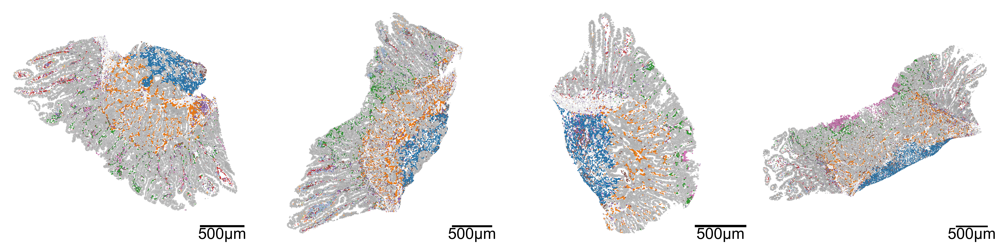

In [3]:
# Create a figure with 1 row and 4 columns for subplots
fig, ax = plt.subplots(1, 4, figsize=(40, 10))
plt.subplots_adjust(wspace=0.1)  # Adjust the space between subplots

# Loop through each domain of interest
for i, domain_of_interest in enumerate(muspan_files):
    # Load the domain data
    pc = ms.io.load_domain(path_to_domain=domain_of_interest, print_summary=False)

    # Visualize the loaded domain
    ms.visualise.visualise(
        pc,
        ax=ax[i],  # Assign the current subplot axis
        color_by=this_label_name,  # Color by cluster ID
        objects_to_plot=('collection', 'Cell boundaries'),  # Specify objects to plot
        add_cbar=False,  # Do not add color bar
        add_scalebar=True,  # Add scale bar
        shape_kwargs=shape_kwargs_cells,  # Shape parameters for cells
        scalebar_kwargs=dict(
            size=500,  # Size of the scale bar
            label='500µm',  # Label for the scale bar
            loc='lower right',  # Location of the scale bar
            fontproperties=fm.FontProperties(size=45),  # Font properties for the label
            pad=0,  # Padding for the scale bar
            size_vertical=20,  # Vertical size of the scale bar
            zorder=1000  # Z-order for layering
        ),
    )

# Set the figure background to be transparent
fig.patch.set_alpha(0.0)

(np.float64(0.0), np.float64(1.0), np.float64(0.0), np.float64(1.0))

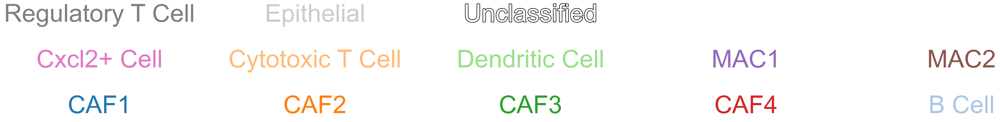

In [13]:
import matplotlib.patheffects as path_effects

all_of_interest_with_unclass = ['CAF1',
                                 'CAF2',
                                 'CAF3',
                                 'CAF4',
                                 'B Cell',
                                 'Cxcl2+ Cell',
                                 'Cytotoxic T Cell',
                                 'Dendritic Cell',
                                 'MAC1',
                                 'MAC2',
                                 'Regulatory T Cell',
                                 'Epithelial',
                                 'Unclassified']


fig, ax = plt.subplots(1, 1, figsize=(7, 2.5))
for i, cell_type in enumerate(all_of_interest_with_unclass):
    if cell_type is 'Unclassified':
        ax.text(i % 5, 0.6*(i // 5), cell_type, color=cell_color_final[cell_type], fontsize=45, ha='center', va='center',path_effects=[
                path_effects.Stroke(linewidth=2, foreground='black'),
                path_effects.Normal()
            ])


    else:
        ax.text(i % 5, 0.6*(i // 5), cell_type, color=cell_color_final[cell_type], fontsize=45, ha='center', va='center')
ax.axis('off')

###  Region locations 

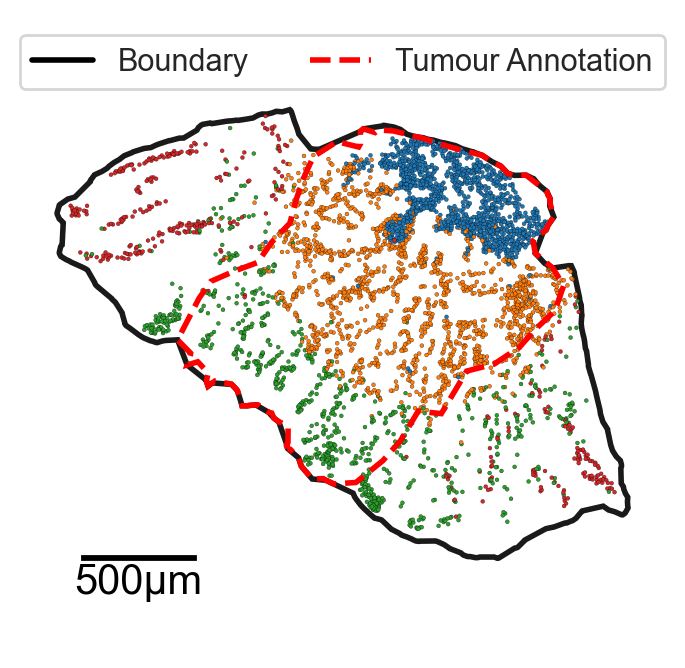

In [4]:
# Define visualization parameters for tumour annotation and boundaries
shape_kwargs_tumour_annotation = dict(
    fill=False,
    linestyle='--',
    linewidth=2,
    alpha=1,
    edgecolor='Red',
    zorder=100
)

boundary_kwargs = dict(
    linewidth=2,
    linestyle='-',
    alpha=1
)

marker_kwargs = dict(
    edgecolor='black',
    linewidth=0.1,
    alpha=1
)

# Create a figure for visualization
fig, ax = plt.subplots(figsize=(3.5, 3.5))

# Specify the tumour of interest
tumour_of_interest = 'Ad_top_region_1.muspan'

# Load the domain data for the specified tumour
pc = ms.io.load_domain(path_to_domain='../temp_domains/' + tumour_of_interest, print_summary=False)

# Query for centroids and boundaries
query_centroids = ms.query.query(pc, ('collection',), 'is', 'Centroids')
query_boundaries = ms.query.query(pc, ('collection',), 'is', 'Cell boundaries')

# Query for cells in and not in the tumour region
query_in_tumour = ms.query.query(pc, ('collection',), 'is', 'In Tumour Region')
query_not_in_tumour = ms.query.query(pc, ('collection',), 'is not', 'In Tumour Region')

# Get the queried cells
q_cells_in_tumour = ms.query.query_container(query_in_tumour, 'AND', query_centroids, pc)
q_cells_not_in_tumour = ms.query.query_container(query_not_in_tumour, 'AND', query_centroids, pc)

# Query for focus cells and their boundaries
query_focus_cell = ms.query.query(pc, ('label', this_label_name), 'in', focus_cells)
query_focus_cell_boundaries = ms.query.query_container(query_focus_cell, 'AND', query_centroids, pc)

# Visualize the focus cell boundaries
ms.visualise.visualise(
    pc,
    ax=ax,
    objects_to_plot=query_focus_cell_boundaries,
    color_by=this_label_name,
    add_cbar=False,
    scatter_kwargs=marker_kwargs,
    marker_size=2,
)

# Visualize the tumour region with specified parameters
ms.visualise.visualise(
    pc,
    ax=ax,
    objects_to_plot=('collection', 'Tumour Region'),
    shape_kwargs=shape_kwargs_tumour_annotation,
    add_cbar=False,
    show_boundary=True,
    boundary_kwargs=boundary_kwargs,
    add_scalebar=True,
    scalebar_kwargs=dict(
        size=500,
        label='500µm',
        fontproperties=fm.FontProperties(size=15),
        pad=1,
        size_vertical=10
    ),
)

# Set the figure background to be transparent
fig.patch.set_alpha(0)

# Add a legend to the plot
handles = [
    plt.Line2D([0], [0], color='black', lw=2, label='Boundary'),
    plt.Line2D([0], [0], color='red', linestyle='--', lw=2, label='Tumour Annotation')
]
ax.legend(handles=handles, loc='upper center', bbox_to_anchor=(0.5, 1), ncol=2)

In [5]:
# Initialize an empty list to store proportions of fibroblasts
list_of_fib_proportions = []

# Loop through each muspan file
for file in muspan_files:
    # Load the domain data from the muspan file
    pc = ms.io.load_domain(path_to_domain=file, print_summary=False)
    
    # Query for centroids and boundaries
    query_centroids = ms.query.query(pc, ('collection',), 'is', 'Centroids')
    query_boundaries = ms.query.query(pc, ('collection',), 'is', 'Cell boundaries')
    
    # Query for cells in and not in the tumour region
    query_in_tumour = ms.query.query(pc, ('collection',), 'is', 'In Tumour Region')
    query_not_in_tumour = ms.query.query(pc, ('collection',), 'is not', 'In Tumour Region')

    # Get the queried cells
    q_cells_in_tumour = ms.query.query_container(query_in_tumour, 'AND', query_centroids, pc)
    q_cells_not_in_tumour = ms.query.query_container(query_not_in_tumour, 'AND', query_centroids, pc)
    
    # Get counts of fibroblasts in the tumour annotation
    counts, labels = ms.summary_statistics.label_counts(pc, label_name=this_label_name, population=query_centroids)
    counts_in_tumour, labels_in_tumour = ms.summary_statistics.label_counts(pc, label_name=this_label_name, population=q_cells_in_tumour)
    
    # Initialize an array to hold the proportion of fibroblasts
    this_prop_of_fibroblasts = np.zeros(len(focus_cells))
    
    # Calculate the proportion of fibroblasts in the tumour
    for i, cell in enumerate(focus_cells):
        in_tumour_count = counts_in_tumour[labels_in_tumour == cell]
        in_domain_count = counts[labels == cell] 
        this_prop_of_fibroblasts[i] = (in_tumour_count / in_domain_count)
        
    # Append the proportions to the list
    list_of_fib_proportions.append(this_prop_of_fibroblasts)
        
# Stack the list of proportions into a 2D numpy array
list_of_fib_proportions = np.vstack(list_of_fib_proportions)

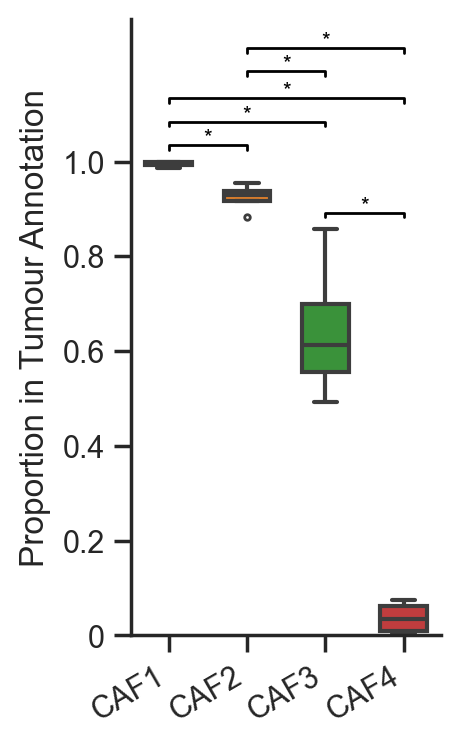

In [6]:
# Create a DataFrame from the list of fibroblast proportions with focus cells as columns
df = pd.DataFrame(list_of_fib_proportions, columns=focus_cells)

# Initialize a figure and axis for the boxplot
fig, ax = plt.subplots(figsize=(2, 4))

# Create a boxplot for the proportions of fibroblasts in tumor annotations
sns.boxplot(data=df, ax=ax, palette=cell_color_final, linewidth=1.5, fliersize=2, width=0.6)

# Set x-tick labels and rotate them for better visibility
ax.set_xticklabels(focus_cells, rotation=30, ha='right')   
ax.set_ylabel('Proportion in Tumour Annotation')

# Remove the top and right spines for a cleaner look
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Initialize a list to keep track of bracket heights to avoid overlap
bracket_levels = []  # Each element: (x_start, x_end, y_level)

def get_next_free_y(x_start, x_end, base_y):
    """Returns a y-value that avoids overlapping with previous brackets"""
    y = base_y
    margin = 0.05  # vertical spacing between brackets
    while any((xs <= x_end and xe >= x_start and abs(yl - y) < margin)
              for xs, xe, yl in bracket_levels):
        y += margin
    return y

# Compute all pairwise comparisons and draw brackets for significant differences
for cell_a, cell_b in itertools.combinations(focus_cells, 2):
    # Perform Mann-Whitney U test to compare distributions
    stat, p_value = mannwhitneyu(df[cell_a], df[cell_b])
    
    # If the p-value is less than 0.05, draw a bracket
    if p_value < 0.05:
        x1 = focus_cells.index(cell_a)
        x2 = focus_cells.index(cell_b)
        x_start, x_end = min(x1, x2), max(x1, x2)

        # Base height just above the max of the two boxes
        y_base = max(df[cell_a].max(), df[cell_b].max()) + 0.025
        y = get_next_free_y(x_start, x_end, y_base)

        # Draw the bracket
        ax.plot([x1, x1, x2, x2], [y, y + 0.01, y + 0.01, y], color='black', lw=1)
        ax.text((x1 + x2) / 2, y + 0.005, '*', ha='center', va='bottom', color='black', fontsize=8)

        # Register the bracket so future ones avoid this height
        bracket_levels.append((x_start, x_end, y))

# Adjust y-axis limits and ticks
ax.set_ylim(0, 1.3)
ax.set_yticks([0, 0.2, 0.4, 0.6, 0.8, 1.0])
ax.set_yticklabels([0, 0.2, 0.4, 0.6, 0.8, 1.0]) 

# Set the figure background to be transparent
fig.patch.set_alpha(0)


### Direct contact analysis

In [7]:
# Initialize empty lists to store adjacency matrices and their labels for different conditions
Healthy_APT = []
Healthy_APT_labels = []

Ad_APT = []
Ad_APT_labels = []

Tumour_APT = []
Tumour_APT_labels = []

# Loop through each muspan file to load and process the data
for file in muspan_files:
    # Load the domain data from the muspan file
    pc = ms.io.load_domain(path_to_domain=file, print_summary=False)
    
    # Query for centroids and boundaries in the loaded data
    query_centroids = ms.query.query(pc, ('collection',), 'is', 'Centroids')
    query_boundaries = ms.query.query(pc, ('collection',), 'is', 'Cell boundaries')

    # Perform adjacency permutation test to analyze contact networks
    SES_tum, A_tum, labels_tum = ms.networks.adjacency_permutation_test(
        pc, 
        network_name='Contact Network', 
        label_name=this_label_name, 
        population=None,
        label_shuffle_iterations=500, 
        alpha=0.05, 
        transform_counts='sqrt', 
        observation_threshold=0
    )
    
    # Initialize an updated adjacency matrix for the current file
    updated_A_tum = np.zeros((len(cell_names), len(cell_names)))
    
    # Populate the updated adjacency matrix with values from the test results
    for lab_A in labels_tum:
        for lab_B in labels_tum:
            updated_A_tum[cell_names.index(lab_A), cell_names.index(lab_B)] = A_tum[labels_tum.tolist().index(lab_A), labels_tum.tolist().index(lab_B)]

    # Append the updated adjacency matrix to the Tumour_APT list
    Tumour_APT.append(updated_A_tum)

Adjacency correlation (main figure)

(-40.0, 40.0)

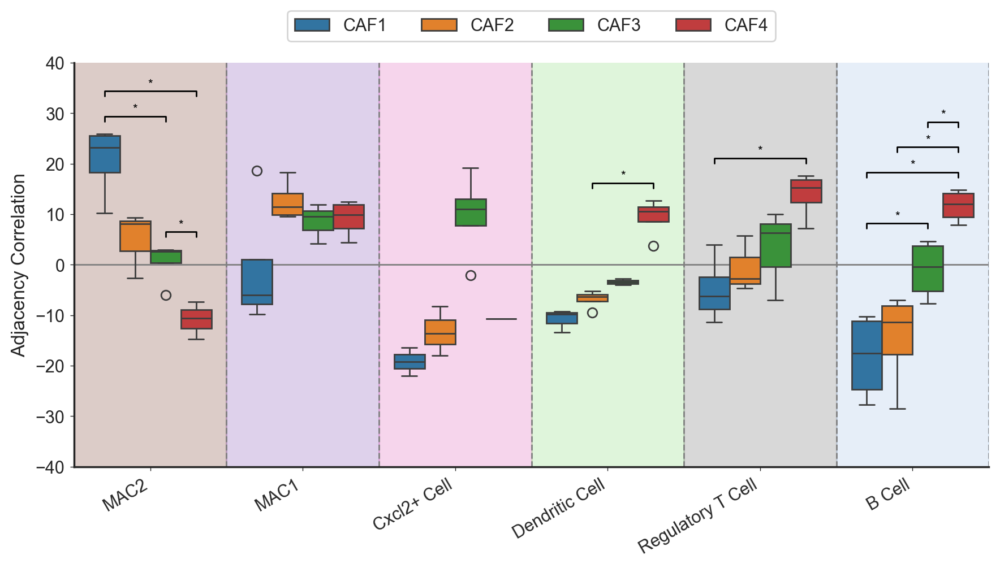

In [8]:
# Start with the focus cells then the target cells 
target_cells_all = [
    'MAC2',
    'MAC1',
    'Cxcl2+ Cell',
    'Dendritic Cell',
    'Regulatory T Cell',
    'B Cell']

# Get the indices of focus and target cells
index_of_focus_cells = [cell_names.index(cell) for cell in focus_cells]
index_of_target_cells = [cell_names.index(cell) for cell in target_cells_all]

# Initialize a list to hold densities for focus cells
list_of_focus_densitities = []
for i, focus in enumerate(focus_cells):
    this_focus_contacts = []
    # Collect contact densities for each APT
    for apt in Tumour_APT:
        this_apt_array = apt[index_of_focus_cells[i], index_of_target_cells]
        this_focus_contacts.append(this_apt_array)
    list_of_focus_densitities.append(np.vstack(this_focus_contacts))

# Create a dataframe for grouped box plot
grouped_data = []
for i, focus_cell in enumerate(focus_cells):
    for j, target_cell in enumerate(target_cells_all):
        for density in list_of_focus_densitities[i][:, j]:
            grouped_data.append({
                'Fibroblast label': focus_cell, 
                'Cell type': target_cell, 
                'Adjacency Correlation': density,
                'Color': cell_color_final.get(target_cell, '#000000')  # Default to black if not found
            })

# Convert the grouped data into a DataFrame
df_grouped = pd.DataFrame(grouped_data)

# Create the grouped box plot
fig, ax = plt.subplots(figsize=(9, 5.5))
ax.axhline(0, color='grey', linestyle='-', linewidth=1, zorder=-10)
adj_box = sns.boxplot(data=df_grouped, x='Cell type', y='Adjacency Correlation', hue='Fibroblast label', ax=ax, palette=cell_color_final, showfliers=True)
ax.set_xticklabels(target_cells_all, rotation=30, ha='right')   

# Fill between the cells for better visualization
for i, cell in enumerate(target_cells_all):
    ax.fill_between(x=[i-0.5, i + 0.5], y1=-50, y2=50, color=cell_color_final[cell], alpha=0.3, zorder=-20)
    ax.axvline(i + 0.5, color='gray', linestyle='--', linewidth=1)

# Add legend and remove spines
ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.15), ncol=4)
sns.despine(ax=ax)

# Adjust tick parameters
ax.tick_params(length=2.5, width=0.5)

# Set limits for the plot
# ax.set_ylim(0, 1.3)

# Set transparent background
fig.patch.set_alpha(0)

bracket_levels = []
margin = 5

# Function to find the next free y position for significance brackets
def get_next_free_y(x_start, x_end, base_y, margin):
    y = base_y
    while any((xs <= x_end and xe >= x_start and abs(yl - y) < margin)
              for xs, xe, yl in bracket_levels):
        y += margin
    return y

# Prepare for significance testing
cell_pair_for_tests = []
focus_pairs = list(itertools.combinations(focus_cells, 2))

# Draw significance brackets using Mann-Whitney U test
for cell in target_cells_all:
    for pair in focus_pairs:
        data_a = df_grouped[(df_grouped['Fibroblast label'] == pair[0]) & (df_grouped['Cell type'] == cell)]['Adjacency Correlation']
        data_b = df_grouped[(df_grouped['Fibroblast label'] == pair[1]) & (df_grouped['Cell type'] == cell)]['Adjacency Correlation'] 
        data_a = data_a.dropna()
        data_b = data_b.dropna()
        stat, p_value = mannwhitneyu(data_a, data_b)
        
        # Check for significance
        if p_value < 0.05:
            x1 = target_cells_all.index(cell) + (-0.3 + focus_cells.index(pair[0]) * 0.2)
            x2 = target_cells_all.index(cell) + (-0.3 + focus_cells.index(pair[1]) * 0.2)
            x_start, x_end = min(x1, x2), max(x1, x2)

            y_base = max(data_a.max(), data_b.max()) + margin / 2
            y = get_next_free_y(x_start, x_end, y_base, margin)

            # Draw the significance bracket
            ax.plot([x1, x1, x2, x2], [y, y + margin / 5, y + margin / 5, y], color='black', lw=1)
            if p_value < 0.001:
                ax.text((x1 + x2) / 2, y + margin / 2, '***', ha='center', va='center', color='black', fontsize=8)
            elif p_value < 0.01:
                ax.text((x1 + x2) / 2, y + margin / 2, '**', ha='center', va='center', color='black', fontsize=8)
            elif p_value < 0.05:
                ax.text((x1 + x2) / 2, y + margin / 2, '*', ha='center', va='center', color='black', fontsize=8)
            bracket_levels.append((x_start, x_end, y))

# Tight layout for the figure
fig.tight_layout()

# Remove bottom x label
ax.set_xlabel('')
ax.set_xlim(-0.5, (len(target_cells_all) - 1) + 0.5)
ax.set_ylim(-40, 40)

Adjacency correlation (SI figure)

(-0.5, 10.5)

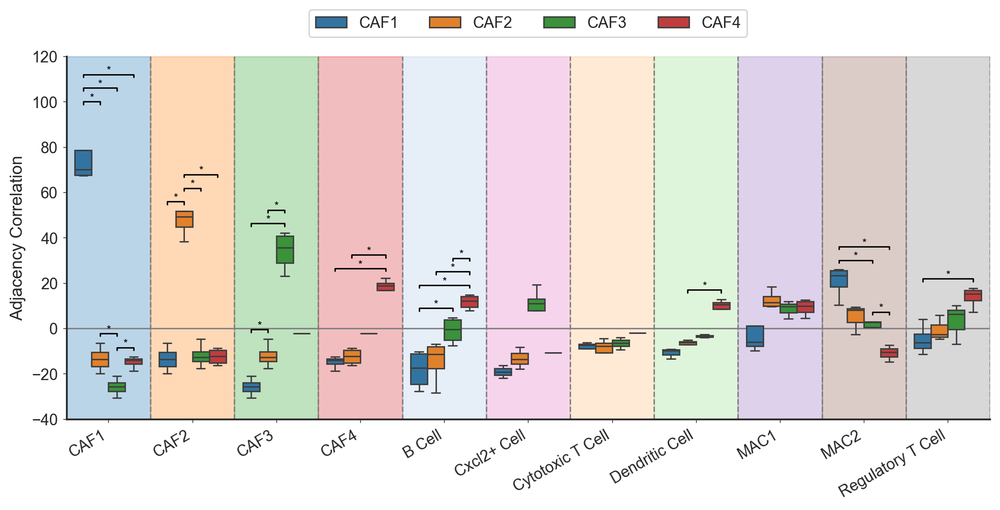

In [9]:
# Combine focus cells and target cells
target_cells_all = focus_cells + target_cells 

# Get indices of focus and target cells
index_of_focus_cells = [cell_names.index(cell) for cell in focus_cells]
index_of_target_cells = [cell_names.index(cell) for cell in target_cells_all]

# Initialize list to store densities for focus cells
list_of_focus_densitities = []
for i, focus in enumerate(focus_cells):
    this_focus_contacts = []
    # Collect contact data for each APT
    for apt in Tumour_APT:
        this_apt_array = apt[index_of_focus_cells[i], index_of_target_cells]
        this_focus_contacts.append(this_apt_array)
    list_of_focus_densitities.append(np.vstack(this_focus_contacts))
    
# Prepare data for grouped box plot
grouped_data = []
for i, focus_cell in enumerate(focus_cells):
    for j, target_cell in enumerate(target_cells_all):
        for density in list_of_focus_densitities[i][:, j]:
            grouped_data.append({
                'Fibroblast label': focus_cell, 
                'Cell type': target_cell, 
                'Adjacency Correlation': density,
                'Color': cell_color_final.get(target_cell, '#000000')  # Default to black if not found
            })

# Create a DataFrame from the grouped data
df_grouped = pd.DataFrame(grouped_data)

# Create the grouped box plot
fig, ax = plt.subplots(figsize=(10, 5.5))
ax.axhline(0, color='grey', linestyle='-', linewidth=1, zorder=-10)
adj_box = sns.boxplot(data=df_grouped, x='Cell type', y='Adjacency Correlation', hue='Fibroblast label', ax=ax, palette=cell_color_final, showfliers=False)
ax.set_xticklabels(target_cells_all, rotation=30, ha='right')  

# Fill between the boxes for visual clarity
for i, cell in enumerate(target_cells_all):
    ax.fill_between(x=[i-0.5, i + 0.5], y1=-50, y2=120, color=cell_color_final[cell], alpha=0.3, zorder=-20)
    ax.axvline(i + 0.5, color='gray', linestyle='--', linewidth=1)

# Set legend and remove spines for aesthetics
ax.legend(loc='upper center', bbox_to_anchor=(0.5, 1.15), ncol=4)
sns.despine(ax=ax)
ax.tick_params(length=2.5, width=0.5)

# Set limits and background transparency
ax.set_ylim(-40, 120)
fig.patch.set_alpha(0)

# ---- Significance Brackets (Minimal Style) ---- #
bracket_levels = []
margin = 6

# Function to find the next free y position for significance brackets
def get_next_free_y(x_start, x_end, base_y, margin):
    y = base_y
    while any((xs <= x_end and xe >= x_start and abs(yl - y) < margin)
              for xs, xe, yl in bracket_levels):
        y += margin
    return y

# Prepare for significance testing
cell_pair_for_tests = []
focus_pairs = list(itertools.combinations(focus_cells, 2))

# Draw significance brackets using Mann-Whitney U test
for cell in target_cells_all:
    for pair in focus_pairs:
        data_a = df_grouped[(df_grouped['Fibroblast label'] == pair[0]) & (df_grouped['Cell type'] == cell)]['Adjacency Correlation']
        data_b = df_grouped[(df_grouped['Fibroblast label'] == pair[1]) & (df_grouped['Cell type'] == cell)]['Adjacency Correlation'] 
        stat, p_value = mannwhitneyu(data_a, data_b)
        
        # Check for significance
        if p_value < 0.05:
            x1 = target_cells_all.index(cell) + (-0.3 + focus_cells.index(pair[0]) * 0.2)
            x2 = target_cells_all.index(cell) + (-0.3 + focus_cells.index(pair[1]) * 0.2)
            x_start, x_end = min(x1, x2), max(x1, x2)

            y_base = max(data_a.max(), data_b.max()) + margin / 2
            y = get_next_free_y(x_start, x_end, y_base, margin)

            # Draw the significance bracket
            ax.plot([x1, x1, x2, x2], [y, y + margin / 5, y + margin / 5, y], color='black', lw=1)
            # Annotate significance level
            if p_value < 0.001:
                ax.text((x1 + x2) / 2, y + margin / 2, '***', ha='center', va='center', color='black', fontsize=8)
            elif p_value < 0.01:
                ax.text((x1 + x2) / 2, y + margin / 2, '**', ha='center', va='center', color='black', fontsize=8)
            elif p_value < 0.05:
                ax.text((x1 + x2) / 2, y + margin / 2, '*', ha='center', va='center', color='black', fontsize=8)
            bracket_levels.append((x_start, x_end, y))

# Tight layout for the figure
fig.tight_layout()

# Remove bottom x label and set x limits
ax.set_xlabel('')
ax.set_xlim(-0.5, (len(target_cells_all) - 1) + 0.5)


### TCM analysis

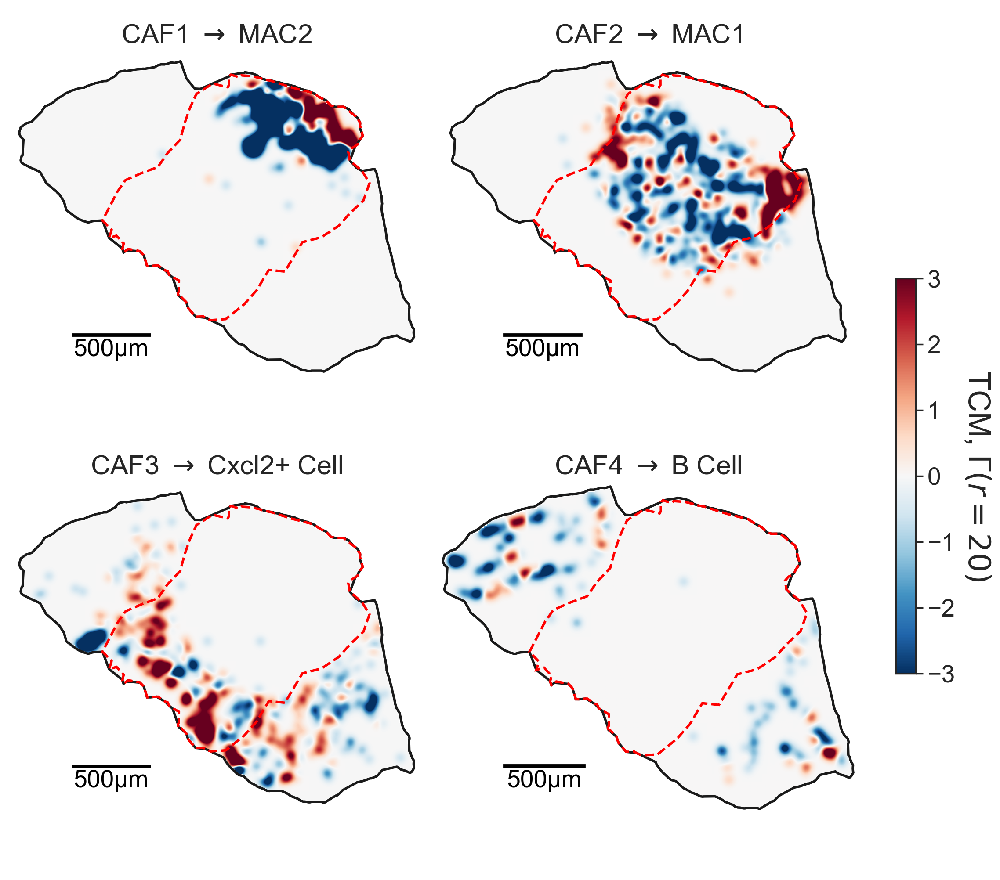

In [11]:
# Define the tumour of interest and visualization parameters
tumour_of_interest = 'Ad_top_region_1.muspan'
clim = 5
shape_kwargs_tumour_annotation = dict(fill=False, linestyle='--', linewidth=2, alpha=1, edgecolor='Red', zorder=100) 
boundary_kwargs = dict(linewidth=2, linestyle='-', alpha=1) 

# Scalebar settings
add_scalebar = True
scalebar_kwargs = dict(size=500, label='500µm', fontproperties=fm.FontProperties(size=20), pad=2.5, size_vertical=15)

# Flag to plot points
plot_points = False

# Load the domain and query centroids and boundaries
pc = ms.io.load_domain(path_to_domain='../temp_domains/' + tumour_of_interest, print_summary=False)
query_centroids = ms.query.query(pc, ('collection',), 'is', 'Centroids')
query_boundaries = ms.query.query(pc, ('collection',), 'is', 'Cell boundaries')

# Define cell pairs and titles for visualization
cell_pair_1 = ['CAF1', 'MAC2']
cell_pair_2 = ['CAF2', 'MAC1']
cell_pair_3 = ['CAF3', 'Cxcl2+ Cell']
cell_pair_4 = ['CAF4', 'B Cell']   

cell_pairs = [cell_pair_1, cell_pair_2, cell_pair_3, cell_pair_4]
titles = ['CAF1 $\\rightarrow$ MAC2',
          'CAF2 $\\rightarrow$ MAC1',
          'CAF3 $\\rightarrow$ Cxcl2+ Cell',
          'CAF4 $\\rightarrow$ B Cell']

# Create subplots for visualization
fig, ax = plt.subplots(2, 2, figsize=(10, 10))

# Loop through each cell pair for visualization
for cell_pair in cell_pairs:
    # Create queries for the cell pair
    query_a = ms.query.query_container((this_label_name, cell_pair[0]), 'AND', query_centroids, pc)
    query_b = ms.query.query_container((this_label_name, cell_pair[1]), 'AND', query_centroids, pc)
    query_both = ms.query.query_container(query_a, 'OR', query_b, pc)  
    
    cell_pair_string = f"{cell_pair[0]} $\\rightarrow$ {cell_pair[1]}"
    
    # Generate the topographical correlation map (TCM)
    this_TCM = ms.spatial_statistics.topographical_correlation_map(
        pc,
        query_a,
        query_b,
        radius_of_interest=20,
        kernel_radius=80,
        kernel_sigma=25,
        kernel_function=None,
        mesh_step=10,
        max_correlation_threshold=3,
        remain_within_connected_component=False,
        add_contribution_as_labels=False,
        contribution_label_name=cell_pair_string,
        visualise_output=False,
        visualise_tcm_kwargs={}
    )
    
    # Visualize the TCM
    ms.visualise.visualise_topographical_correlation_map(
        domain=pc,
        TCM=this_TCM,
        ax=ax.flatten()[cell_pairs.index(cell_pair)],
        add_cbar=False,
        colorbar_limit=clim,
        tcm_cmap='RdBu_r',
        colorbar_label='TCM, $\\Gamma$',
        TCM_zorder=0,
        objects_to_plot=False,
        figure_kwargs={},
        visualise_kwargs={}
    )
    
    # Optionally plot points
    if plot_points:
        ms.visualise.visualise(
            pc,
            ax=ax.flatten()[cell_pairs.index(cell_pair)],
            objects_to_plot=query_both,
            color_by=this_label_name,
            add_cbar=False,
            marker_size=0.1
        )
    
    # Visualize the tumour region
    ms.visualise.visualise(
        pc,
        ax=ax.flatten()[cell_pairs.index(cell_pair)],
        objects_to_plot=('collection', 'Tumour Region'),
        shape_kwargs=shape_kwargs_tumour_annotation,
        add_cbar=False,
        show_boundary=True,
        boundary_kwargs=boundary_kwargs,
        add_scalebar=True,
        scalebar_kwargs=scalebar_kwargs,
    )

    # Set the title for the subplot
    ax.flatten()[cell_pairs.index(cell_pair)].set_title(titles[cell_pairs.index(cell_pair)], fontsize=22, y=0.9, loc='center')
    
    # Uncomment to improve cell pair display on axis
    # ax.flatten()[cell_pairs.index(cell_pair)].set_title(cell_pair_string, fontsize=15, pad=-30, loc='center')

# Add colorbar to the figure
ax_3 = fig.add_axes([0.9, 0, 0.15, 0.9])  
norm = plt.Normalize(vmin=-3, vmax=3)
cbar = fig.colorbar(plt.cm.ScalarMappable(norm=norm, cmap='RdBu_r'), ax=ax_3, orientation='vertical', pad=0.1, aspect=20, shrink=1.5)    
cbar.set_label('TCM, $\\Gamma (r=20)$', rotation=270, labelpad=30, fontsize=25)
cbar.ax.tick_params(labelsize=20)  # Match tick label fontsize to label size
ax_3.axis('off')

# Set figure transparency
fig.patch.set_alpha(0)

### Neighbourhood analysis

In [3]:
# Define the list of target cells to analyze
all_cells = target_cells  

# Create a list of cells to ignore based on the cell names
ignore_cells = [cell for cell in cell_names if cell not in all_cells]

# Initialize lists to store various data
list_of_pcs = []  # List to hold loaded domain objects
list_of_source_querys = []  # List to hold source queries
list_of_network_names = []  # List to hold network names
   
# Specify the network of interest
network_of_choice = 'Contact Network'

# Loop through each muspan file to load and process the data
for file in muspan_files:
    # Load the domain data from the muspan file
    pc = ms.io.load_domain(path_to_domain=file)
    
    # Append the loaded domain to the list
    list_of_pcs.append(pc)
    
    # Create a query for the source clusters based on the label name and focus cells
    q_cluster_source = ms.query.query(pc, ('label', this_label_name), 'in', focus_cells)
    
    # Create queries for centroids and boundaries in the loaded data
    q_source_centroids = ms.query.query_container(('collection', 'Centroids'), 'AND', q_cluster_source, pc)
    q_source_boundaries = ms.query.query_container(('collection', 'Cell boundaries'), 'AND', q_cluster_source, pc)

    # Append the source boundaries query to the list
    list_of_source_querys.append(q_source_boundaries)
    
    # Append the network name to the list
    list_of_network_names.append(network_of_choice)

MuSpAn domain loaded successfully. Domain summary:
Domain name: Ad_top_region_1
Number of objects: 62571
Collections: ['Cell boundaries', 'Tumour Region', 'In Tumour Region', 'Centroids']
Labels: ['Cell ID', 'Transcript Counts', 'Cell Area', 'Cluster ID', 'Nucleus Area', 'Cluster ID (FINAL)', 'Cluster ID (CLEAN)', 'Cluster ID (SHORT)'] 
Networks: ['Contact Network', 'DT'] 
Distance matrices: []
MuSpAn domain loaded successfully. Domain summary:
Domain name: Ad_top_region_2
Number of objects: 66837
Collections: ['Cell boundaries', 'Tumour Region', 'In Tumour Region', 'Centroids']
Labels: ['Cell ID', 'Transcript Counts', 'Cell Area', 'Cluster ID', 'Nucleus Area', 'Cluster ID (FINAL)', 'Cluster ID (CLEAN)', 'Cluster ID (SHORT)'] 
Networks: ['Contact Network', 'DT'] 
Distance matrices: []
MuSpAn domain loaded successfully. Domain summary:
Domain name: Ad_bottom_region_1
Number of objects: 42161
Collections: ['Cell boundaries', 'Tumour Region', 'In Tumour Region', 'Centroids']
Labels: ['Cel

In [4]:
# Define the number of clusters for k-means clustering
number_of_clusters = 4 

# Perform neighbourhood enrichment analysis
neighbourhood_enrichment_matrix, consistent_global_labels, unique_cluster_labels, observation_matrix = ms.networks.cluster_neighbourhoods(
    list_of_pcs,  # List of loaded domain objects
    this_label_name,  # Label name for clustering
    populations_to_analyse=('collection', 'Cell boundaries'),  # Specify populations to analyze
    neighbourhood_source=list_of_source_querys,  # Source queries for neighbourhoods
    include_boundaries=None,  # Boundaries to include (None means all)
    exclude_boundaries=None,  # Boundaries to exclude (None means none)
    boundary_exclude_distance=0,  # Distance for excluding boundaries
    network_names=list_of_network_names,  # Names of the networks to analyze
    k_hops=3,  # Number of hops to consider in neighbourhood analysis
    force_labels_to_include=target_cells,  # Labels that must be included in the analysis
    labels_to_ignore=ignore_cells,  # Labels to ignore in the analysis
    transform_neighbourhood_composition='sqrt',  # Transformation method for neighbourhood composition
    neighbourhood_label_name='Immune Neighbourhood ID',  # Label for neighbourhoods
    cluster_method='kmeans',  # Clustering method to use
    cluster_parameters={'n_clusters': number_of_clusters},  # Parameters for clustering
    neighbourhood_enrichment_as='zscore',  # Method for neighbourhood enrichment calculation
    return_observation_matrix=True  # Whether to return the observation matrix
)


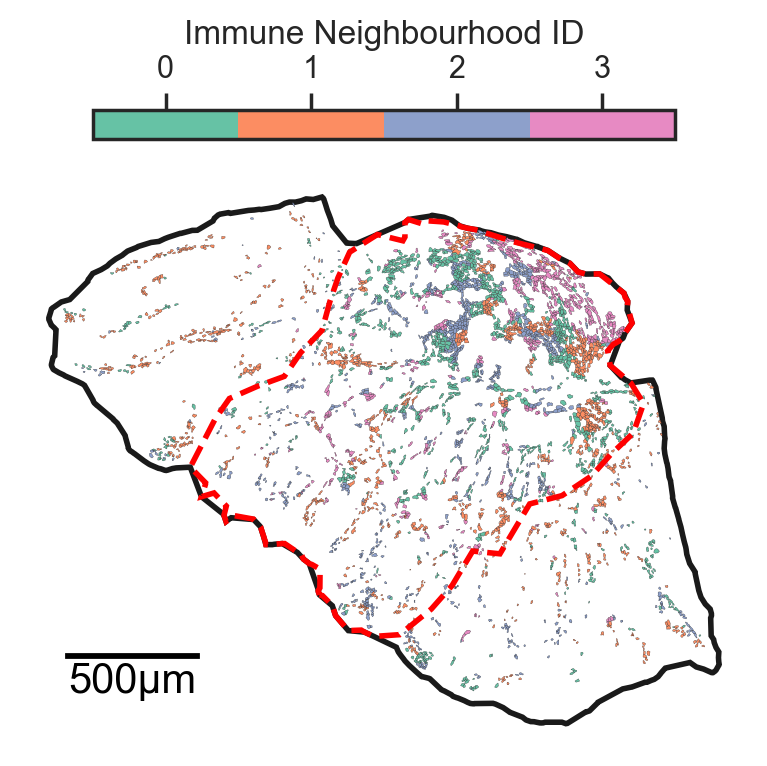

In [11]:
# Generate row colors using the Set2 colormap
row_colors = sns.color_palette("Set2", n_colors=len(unique_cluster_labels))
row_colors_dict = {label: row_colors[i] for i, label in enumerate(unique_cluster_labels)}

# Update colors for each loaded domain
for pc in list_of_pcs:
    pc.update_colors(row_colors_dict, label_name='Immune Neighbourhood ID')

# Choose the last domain to plot
this_pc = list_of_pcs[0]

# Define visualization parameters for tumor annotation and cells
shape_kwargs_tumour_annotation = dict(fill=False, linestyle='--', linewidth=2, alpha=1, edgecolor='Red', zorder=100)
shape_kwargs_cells = dict(linewidth=0.1, alpha=1)
boundary_kwargs = dict(linewidth=2, linestyle='-', alpha=1)
marker_kwargs = dict(edgecolor='black', linewidth=0.1, alpha=1)

# Create a figure and axis for plotting
fig, ax = plt.subplots(figsize=(4, 4))

# Visualize the cells colored by 'Fibroblast Neighbourhood ID'
ms.visualise.visualise(
    this_pc,
    color_by='Immune Neighbourhood ID',
    objects_to_plot=list_of_source_querys[0],
    shape_kwargs=shape_kwargs_cells,
    show_boundary=True,
    boundary_kwargs=boundary_kwargs,
    ax=ax,
    add_scalebar=True,
    scalebar_kwargs=dict(size=500, label='500µm', fontproperties=fm.FontProperties(size=15), pad=1, size_vertical=10),
    cbar_kwargs=dict(location='top', shrink=0.8)
)

# Visualize the tumor region
ms.visualise.visualise(
    this_pc,
    objects_to_plot=('collection', 'Tumour Region'),
    shape_kwargs=shape_kwargs_tumour_annotation,
    add_cbar=False,
    ax=ax
)

# Set the figure background transparency
fig.patch.set_alpha(0)

Reordered y-axis labels: [np.int64(2), np.int64(3), np.int64(0), np.int64(1)]


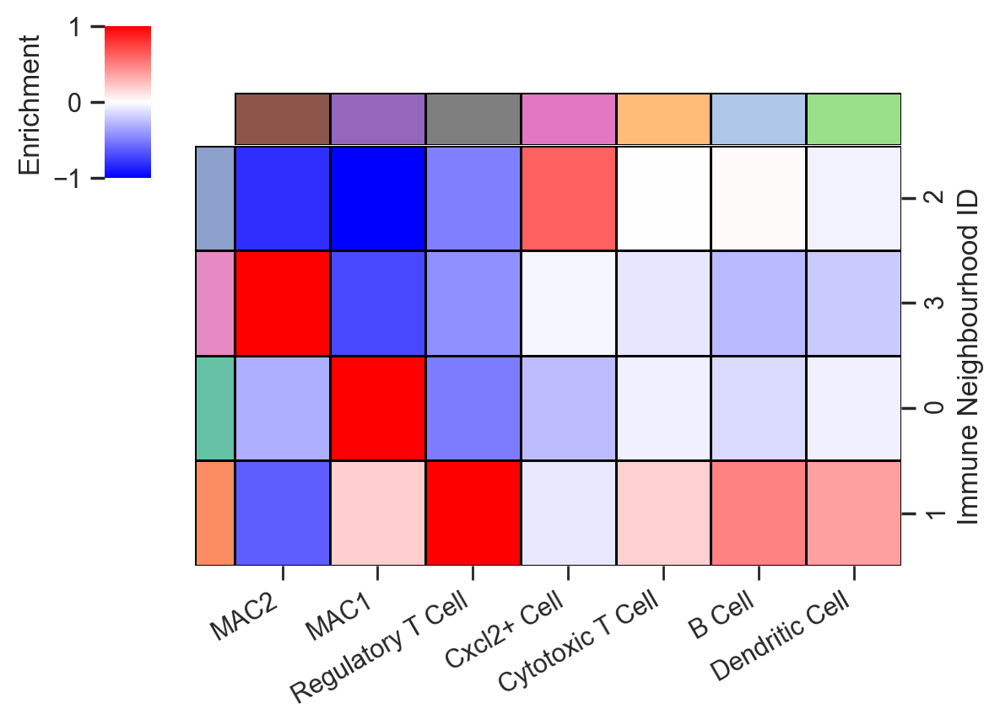

In [12]:
# Create a DataFrame from the neighbourhood enrichment matrix
df_ME_id = pd.DataFrame(data=neighbourhood_enrichment_matrix, 
                        index=unique_cluster_labels, 
                        columns=consistent_global_labels)
df_ME_id.index.name = 'Immune Neighbourhood ID'  # Name the index
df_ME_id.columns.name = 'Cell type'  # Name the columns

# Define colors for the columns based on the cell types
col_colors = [cell_color_final[cell] for cell in consistent_global_labels]

# Visualize the neighbourhood enrichment matrix using a clustermap
clmap = sns.clustermap(
    df_ME_id,
    xticklabels=consistent_global_labels,  # X-axis labels
    yticklabels=unique_cluster_labels,  # Y-axis labels
    figsize=(5.5, 5),  # Adjusted size for better visibility
    cmap='bwr',  # Color map
    dendrogram_ratio=(.1, .1),  # Ratio for the dendrogram
    col_cluster=True,  # Enable column clustering
    row_cluster=True,  # Enable row clustering
    method='ward',  # Clustering method
    row_colors=row_colors,  # Colors for the rows
    col_colors=col_colors,  # Colors for the columns
    square=True,  # Make cells square-shaped
    linewidths=0.5,  # Width of the lines separating cells
    colors_ratio=(0.05, 0.1),  # Ratio for colors
    linecolor='black',  # Color of the lines
    cbar_kws=dict(location='left', label='Enrichment', ticks=[-1, 0, 1], shrink=0.5, aspect=10),  # Colorbar settings
    vmin=-1,  # Minimum value for color scaling
    vmax=1,  # Maximum value for color scaling
    tree_kws={'linewidths': 0, 'color': 'black'}  # Dendrogram line settings
)

# Rotate x-axis labels for better readability
clmap.ax_heatmap.set_xticklabels(clmap.ax_heatmap.get_xticklabels(), rotation=30, ha='right')

# Get the order of the y-axis labels after clustering
y_axis_order = clmap.dendrogram_row.reordered_ind

# Print the reordered y-axis labels
reordered_labels = [unique_cluster_labels[i] for i in y_axis_order]
print("Reordered y-axis labels:", reordered_labels)

#Add ticks to the x-axis
clmap.ax_heatmap.xaxis.set_ticks_position('bottom')  # Set ticks position
clmap.ax_heatmap.xaxis.set_tick_params(width=1)  # Set tick width

clmap.ax_heatmap.set_xlabel('')  # Remove x-axis label
plt.gcf().patch.set_alpha(0)  # Set figure background transparency

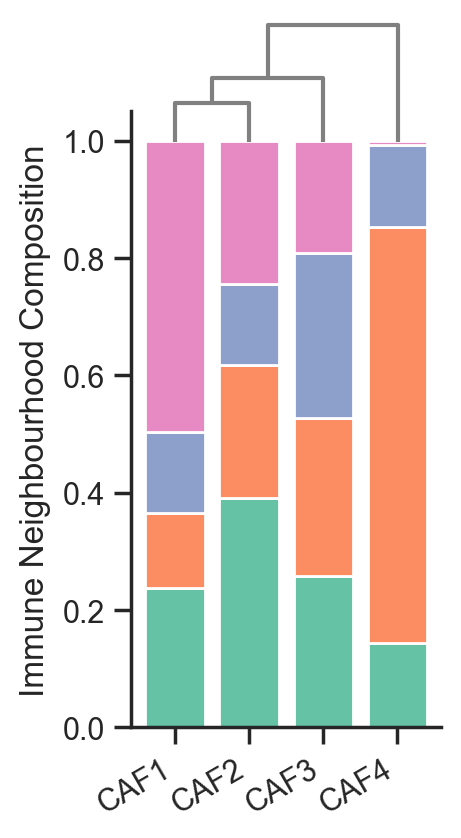

In [8]:
# Initialize an array to hold the number of cells in each cluster
number_of_cells_in_clusters = np.zeros((len(focus_cells), len(unique_cluster_labels)))

# Loop through each loaded domain object
for i, pc in enumerate(list_of_pcs):
    
    # Loop through each focus cell
    for k, cell_id in enumerate(focus_cells):
        # Create a query for the current focus cell
        this_focus_query = ms.query.query_container(list_of_source_querys[i], 'AND', (this_label_name, cell_id), pc)
        
        # Get counts of neighbourhoods and unique cluster IDs for the focus cell
        these_counts_neigh, these_unique_cluster_ids = ms.summary_statistics.label_counts(pc, label_name='Immune Neighbourhood ID', population=this_focus_query)
        
        # Loop through each unique cluster label
        for j, cluster_id in enumerate(unique_cluster_labels):
            # Accumulate the counts of cells in each cluster
            number_of_cells_in_clusters[k, j] += these_counts_neigh[these_unique_cluster_ids == cluster_id]

# Calculate proportions of cells in each cluster
proportions_in_cluster = (number_of_cells_in_clusters / np.sum(number_of_cells_in_clusters, axis=1, keepdims=True)).T

# Create a DataFrame to hold the proportions
df_proportions_in_cluster = pd.DataFrame(proportions_in_cluster, index=unique_cluster_labels, columns=focus_cells)

# Create a stacked bar plot for the proportions
fig, ax = plt.subplots(figsize=(2, 4))
bottom_values = np.zeros(len(proportions_in_cluster[0, :]))  # Initialize bottom values for stacking
x_values = np.arange(len(focus_cells))  # X-axis values for the bar plot

# Loop through each cluster label to create the stacked bars
for i, lab in enumerate(unique_cluster_labels):
    ax.bar(
        x_values,
        proportions_in_cluster[i, :],
        bottom=bottom_values,  # Stack on top of previous bars
        label=df_proportions_in_cluster.index[i],
        color=row_colors_dict[lab]  # Use the corresponding color for the cluster
    )
    bottom_values += proportions_in_cluster[i, :]  # Update bottom values for the next stack

# Set x-ticks and labels
ax.set_xticks(x_values)
ax.set_xticklabels(focus_cells, rotation=30, ha='right')
ax.set_ylabel('Immune Neighbourhood Composition')  # Y-axis label
ax.spines['top'].set_visible(False)  # Hide the top spine
ax.spines['right'].set_visible(False)  # Hide the right spine

# Initialize a distance matrix to calculate distances between focus cells
distance_matrix = np.zeros((len(focus_cells), len(focus_cells)))
for i in range(len(focus_cells)):
    for j in range(len(focus_cells)):
        # Calculate L1 norm (Manhattan distance) between proportions
        distance_matrix[i, j] = np.linalg.norm(proportions_in_cluster[:, i] - proportions_in_cluster[:, j], ord=1)

# Get the upper triangle of the distance matrix
flattened_upper_triangle = distance_matrix[np.triu_indices(len(focus_cells), k=1)]

# Perform hierarchical clustering using the proportions
linked = linkage(proportions_in_cluster.T, method='average', metric='euclidean')

# Create a dendrogram as an inset in the plot
dendro_ax = ax.inset_axes([0.02, 0.95, 0.96, 0.2])  # Add an inset axis for the dendrogram
dendrogram(linked, orientation='top', ax=dendro_ax, color_threshold=0, above_threshold_color='grey', labels=focus_cells, distance_sort='descending', show_leaf_counts=False)
dendro_ax.grid(False)  # Hide the grid

# Hide the ticks and axis for the dendrogram
dendro_ax.set_yticks([])
dendro_ax.set_xticks([])
dendro_ax.set_axis_off()  # Hide the dendrogram axis

# Set the figure background to transparent
fig.patch.set_alpha(0)


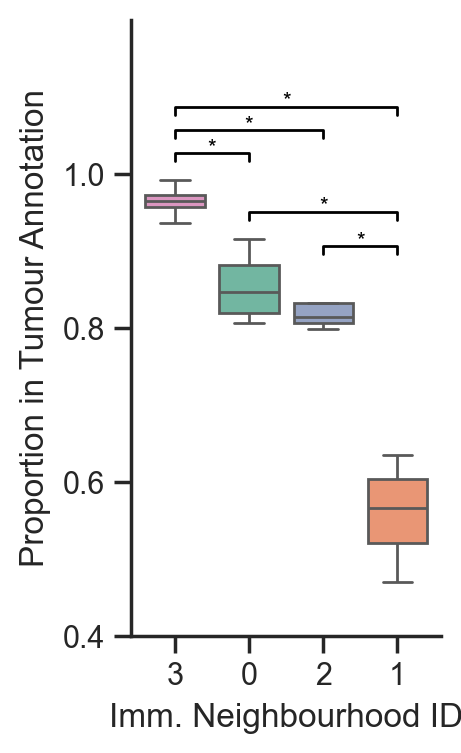

In [10]:
# Initialize an array to hold the number of clusters in the tumor for each domain
number_of_clusters_in_tumour = np.zeros((len(list_of_pcs), len(unique_cluster_labels)))

# Loop through each loaded domain object
for i, pc in enumerate(list_of_pcs):
    # Get the source boundaries for the current domain
    q_source_boundaries = list_of_source_querys[i]
    
    # Create a query to find stroma within the tumor region
    query_stroma_in_tumour = ms.query.query_container(q_source_boundaries, 'AND', ('collection', 'In Tumour Region'), pc)
    
    # Count the neighborhoods and unique cluster IDs for the entire domain
    stroma_neigh_count_domain, strom_id_categories_domain = ms.summary_statistics.label_counts(pc, label_name='Immune Neighbourhood ID')
    
    # Count the neighborhoods and unique cluster IDs for the tumor region
    stroma_neigh_count_tumour, strom_id_categories_tumour = ms.summary_statistics.label_counts(pc, label_name='Immune Neighbourhood ID', population=query_stroma_in_tumour)
    
    # Calculate the proportion of clusters in the tumor and store it
    number_of_clusters_in_tumour[i, :] = stroma_neigh_count_tumour / stroma_neigh_count_domain

# Reorder the columns of number_of_clusters_in_tumour based on mean values
mean_values = np.mean(number_of_clusters_in_tumour, axis=0)
sorted_indices = np.argsort(mean_values)[::-1]  # Get indices of sorted means in descending order
number_of_clusters_in_tumour_sorted = number_of_clusters_in_tumour[:, sorted_indices]
unique_cluster_labels_sorted = np.array(unique_cluster_labels)[sorted_indices].astype(str)

# Create a DataFrame for the box plot
df_clusters_in_tumour = pd.DataFrame(number_of_clusters_in_tumour_sorted, columns=unique_cluster_labels_sorted)

# Plot the box plot
fig, ax = plt.subplots(figsize=(2, 4))
sns.boxplot(data=df_clusters_in_tumour, ax=ax, palette=[row_colors[i] for i in sorted_indices], showfliers=False)

# Set axis labels
ax.set_xlabel('Imm. Neighbourhood ID')
ax.set_ylabel('Proportion in Tumour Annotation')
ax.set_yticks([0.4, 0.6, 0.8, 1])
ax.set_yticklabels([0.4, 0.6, 0.8, 1])

# Remove the top and right axis lines for better aesthetics
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

# Keep track of bracket heights to stack them
bracket_levels = []  # Each element: (x_start, x_end, y_level)

def get_next_free_y(x_start, x_end, base_y):
    """Returns a y-value that avoids overlapping with previous brackets"""
    y = base_y
    margin = 0.03  # Vertical spacing between brackets
    while any((xs <= x_end and xe >= x_start and abs(yl - y) < margin)
              for xs, xe, yl in bracket_levels):
        y += margin
    return y

# Compute all pairwise comparisons and draw brackets
for cell_a, cell_b in itertools.combinations(unique_cluster_labels_sorted, 2):
    stat, p_value = mannwhitneyu(df_clusters_in_tumour[cell_a], df_clusters_in_tumour[cell_b])
    
    if p_value < 0.05:  # Check if the p-value is significant
        x1 = np.where(unique_cluster_labels_sorted == cell_a)[0][0]
        x2 = np.where(unique_cluster_labels_sorted == cell_b)[0][0]
        x_start, x_end = min(x1, x2), max(x1, x2)

        # Base height just above the max of the two boxes
        y_base = max(df_clusters_in_tumour[cell_a].max(), df_clusters_in_tumour[cell_b].max()) + 0.025
        y = get_next_free_y(x_start, x_end, y_base)

        # Draw bracket
        ax.plot([x1, x1, x2, x2], [y, y + 0.01, y + 0.01, y], color='black', lw=1)
        ax.text((x1 + x2) / 2, y + 0.005, '*', ha='center', va='bottom', color='black', fontsize=8)

        # Register the bracket so future ones avoid this height
        bracket_levels.append((x_start, x_end, y))

# Adjust y-axis limits and labels
ax.set_ylim(0.4, 1.2)
ax.set_yticks([0.4, 0.6, 0.8, 1.0])
ax.set_yticklabels([0.4, 0.6, 0.8, 1.0]) 

# Set figure background transparency
fig.patch.set_alpha(0)

# Multiscale analysis - PCFs

In [30]:
# This may take some time as there are a lot of combinations and multiple domains (~10 mins).
# If you want to skip, the pickle file in the next cell is already generated and these results can be loaded directly.

# Define focus cells and target cells for analysis
focus_cells = [
    'CAF1',
    'CAF2',
    'CAF3',
    'CAF4'
]

target_cells = [
    'MAC2',
    'MAC1',
    'Cxcl2+ Cell',
    'Regulatory T Cell'
]

# Set parameters for pair correlation function (PCF)
pcf_parameters = {
    'max_R': 500,
    'annulus_step': 10,
    'annulus_width': 30,
    'include_boundaries': None
}

# Initialize a dictionary to store PCF results
pcf_results_dict = dict()

# Prepare the dictionary for storing results for each combination of focus and target cells
for fcell in focus_cells:
    for tcell in target_cells:
        pcf_results_dict[(fcell, tcell)] = []

run_and_save_pcf = False

# only run and save if needed
if run_and_save_pcf:

    # Loop through each muspan file that is not healthy
    for file in muspan_files:
        # Load the domain data from the muspan file
        pc = ms.io.load_domain(path_to_domain=file)
        
        # Estimate the boundary using the convex hull method
        pc.estimate_boundary(method='convex hull')
        
        # Loop through each focus cell
        for fcell in focus_cells:
            # Create a query for the focus cell
            q_focus = ms.query.query_container((this_label_name, fcell), 'AND', ('collection', 'Centroids'), pc)
            
            # Loop through each target cell
            for tcell in target_cells:
                # Create a query for the target cell
                q_pair_target = ms.query.query_container((this_label_name, tcell), 'AND', ('collection', 'Centroids'), pc)
                
                # Calculate the pair correlation function
                r, g = ms.spatial_statistics.cross_pair_correlation_function(
                    pc,
                    population_A=q_focus,
                    population_B=q_pair_target,
                    **pcf_parameters
                )
                
                # Append the results to the dictionary
                pcf_results_dict[(fcell, tcell)].append(g)
                print(f"Processed {file} for {fcell} and {tcell}")
                
    # Save the pcf_results_dict to a pickle file
    with open('pcf_results_dict_clean_short.pkl', 'wb') as file:
        pickle.dump(pcf_results_dict, file)

MuSpAn domain loaded successfully. Domain summary:
Domain name: Ad_top_region_1
Number of objects: 62571
Collections: ['Cell boundaries', 'Tumour Region', 'In Tumour Region', 'Centroids']
Labels: ['Cell ID', 'Transcript Counts', 'Cell Area', 'Cluster ID', 'Nucleus Area', 'Cluster ID (FINAL)', 'Cluster ID (CLEAN)', 'Cluster ID (SHORT)'] 
Networks: ['Contact Network', 'DT'] 
Distance matrices: []
Processed ../temp_domains/Ad_top_region_1.muspan for CAF1 and MAC2
Processed ../temp_domains/Ad_top_region_1.muspan for CAF1 and MAC1
Processed ../temp_domains/Ad_top_region_1.muspan for CAF1 and Cxcl2+ Cell
Processed ../temp_domains/Ad_top_region_1.muspan for CAF1 and Regulatory T Cell
Processed ../temp_domains/Ad_top_region_1.muspan for CAF2 and MAC2
Processed ../temp_domains/Ad_top_region_1.muspan for CAF2 and MAC1
Processed ../temp_domains/Ad_top_region_1.muspan for CAF2 and Cxcl2+ Cell
Processed ../temp_domains/Ad_top_region_1.muspan for CAF2 and Regulatory T Cell
Processed ../temp_domains/

In [52]:
# only run this is you want to use our computed version - otherwise run the above cell to compute yourself
pcf_path = path_to_local_zenodo_download_file + '/misc_checkpoint_data/pcf_results_dict_clean_short.pkl'

# Load the pcf_results_dict from the file
with open(pcf_path, 'rb') as file:
    pcf_results_dict = pickle.load(file)

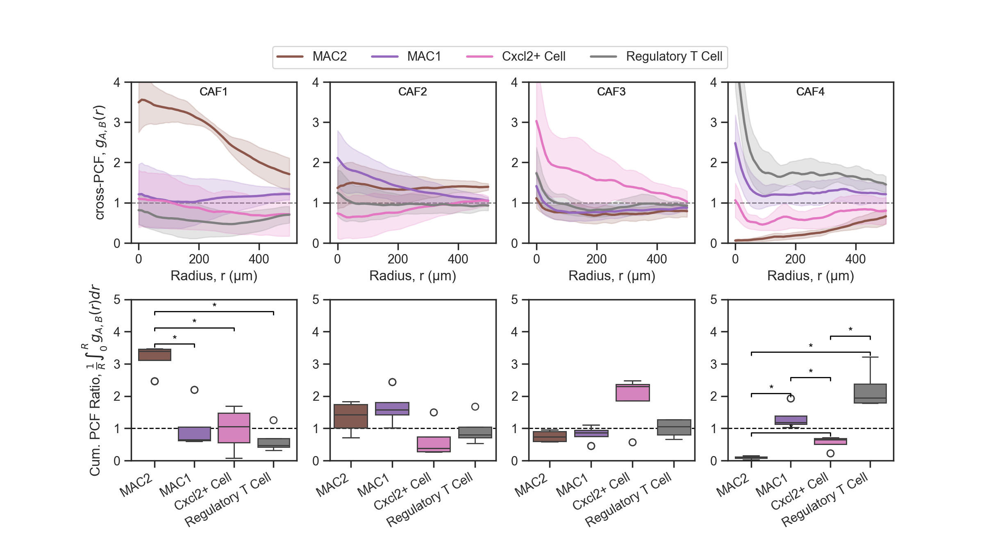

In [55]:
# Define focus and target cell types
focus_cells = [
    'CAF1',
    'CAF2',
    'CAF3',
    'CAF4'
]

target_cells = [
    'MAC2',
    'MAC1',
    'Cxcl2+ Cell',
    'Regulatory T Cell'
]

# Set parameters for pair correlation function (PCF)
pcf_parameters = {
    'max_R': 500,
    'annulus_step': 10,
    'annulus_width': 30,
    'include_boundaries': None
}

# Create an array of radius values
r = np.arange(0, pcf_parameters['max_R'] + pcf_parameters['annulus_step'], pcf_parameters['annulus_step'])

# Delete existing DataFrames for boxplots if they exist
for i in range(4):
    if f'df_boxplot_{i}' in globals():
        del globals()[f'df_boxplot_{i}']


fig, ax = plt.subplots(2, 4, figsize=(12, 6), gridspec_kw={'hspace': 0.35})
for key in pcf_results_dict:
    
    stacked_results= np.vstack(pcf_results_dict[key])
    this_mean = np.mean(stacked_results, axis=0)  

    this_upper_CI = this_mean + 1.96 * np.std(stacked_results, axis=0) / np.sqrt(stacked_results.shape[0])
    this_lower_CI = this_mean - 1.96 * np.std(stacked_results, axis=0) / np.sqrt(stacked_results.shape[0])
    
    if key[0]==focus_cells[0]:
        this_ax = ax[0,0] 
        this_ax.text(0.5, 0.9, key[0], transform=this_ax.transAxes, ha='center', va='bottom', fontsize=10)

        
    elif key[0]==focus_cells[1]:
        this_ax = ax[0,1]
        this_ax.text(0.5, 0.9, key[0], transform=this_ax.transAxes, ha='center', va='bottom', fontsize=10)
 

    elif key[0]==focus_cells[2]:
        this_ax = ax[0,2] 
        this_ax.text(0.5, 0.9, key[0], transform=this_ax.transAxes, ha='center', va='bottom', fontsize=10)


    elif key[0]==focus_cells[3]:
        this_ax = ax[0,3] 
        this_ax.text(0.5, 0.9, key[0], transform=this_ax.transAxes, ha='center', va='bottom', fontsize=10)


    else:
        raise ValueError("Unexpected focus cell")   
        
    if key[1]==target_cells[0]:
        this_color = cell_color_final[target_cells[0]]
        this_label = target_cells[0] 
        
    elif key[1]==target_cells[1]:
        this_color = cell_color_final[target_cells[1]]
        this_label = target_cells[1] 

    elif key[1]==target_cells[2]:
        this_color = cell_color_final[target_cells[2]] 
        this_label = target_cells[2] 

    elif key[1]==target_cells[3]:
        this_color= cell_color_final[target_cells[3]]
        this_label = target_cells[3] 

    else:
        raise ValueError("Unexpected target cell")

    this_ax.axhline(1, color='grey', linestyle='--', linewidth=1,zorder=0)  
    this_ax.plot(r, this_mean, color=this_color, label=this_label,linestyle='-', linewidth=2)   
    this_ax.fill_between(r, this_lower_CI, this_upper_CI, color=this_color, alpha=0.2,linestyle='None')
    this_ax.set_xlabel('Radius, r (μm)')
    #this_ax.set_title(key[0])
    this_ax.set_ylim(0, 4)
    #this_ax.legend()
    if key[0]==focus_cells[0]:
        this_ax.set_ylabel('cross-PCF, $g_{A,B}(r)$')
    

for key in pcf_results_dict:
        
    
    #print(stacked_results)
    
    if key[0]==focus_cells[0]:
        this_ax = ax[1,0] 
                
    elif key[0]==focus_cells[1]:
        this_ax = ax[1,1] 

    elif key[0]==focus_cells[2]:
        this_ax = ax[1,2] 

    elif key[0]==focus_cells[3]:
        this_ax = ax[1,3] 

    else:
        raise ValueError("Unexpected focus cell")   
        
    if key[1]==target_cells[0]:
        this_color = cell_color_final[target_cells[0]]
        this_label = target_cells[0] 
        
    elif key[1]==target_cells[1]:
        this_color = cell_color_final[target_cells[1]]
        this_label = target_cells[1] 

    elif key[1]==target_cells[2]:
        this_color = cell_color_final[target_cells[2]] 
        this_label = target_cells[2] 

    elif key[1]==target_cells[3]:
        this_color= cell_color_final[target_cells[3]]
        this_label = target_cells[3] 

    else:
        raise ValueError("Unexpected target cell")
    
    all_ints = []
    stacked_results = np.vstack(pcf_results_dict[key])  
    for k in range(np.shape(stacked_results)[0]):
        this_g = stacked_results[k,r<150]
        this_int = (1/(150)) * np.trapz(this_g, dx=pcf_parameters['annulus_step'])
        all_ints.append(this_int) 
    
    # Create a DataFrame for the box plot
    
    if key[0]==focus_cells[0]:
        this_ax = ax[1,0] 
        df_all_ints_0 = pd.DataFrame({'Target Cell': [key[1]] * len(all_ints), 'Integrated PCF': all_ints})
        # Append the data to a global DataFrame for all keys
        if 'df_boxplot_0' not in globals():
            df_boxplot_0 = df_all_ints_0
        else:
            df_boxplot_0 = pd.concat([df_boxplot_0, df_all_ints_0], ignore_index=True)

        # Plot the box plot
        sns.boxplot(data=df_boxplot_0, x='Target Cell', y='Integrated PCF', ax=this_ax, palette=cell_color_final)
        #this_ax.set_xticklabels(this_ax.get_xticklabels(), rotation=45, ha='right')
        this_ax.set_xticklabels(target_cells, rotation=30, ha='right') 
        this_ax.set_ylabel('Cum. PCF Ratio, $\\frac{1}{R}\\int_{0}^{R} g_{A,B}(r) dr$')  # Remove x-label for the first row    
        this_ax.set_xlabel('')  # Remove x-label for the first row  

        
    elif key[0]==focus_cells[1]:
        this_ax = ax[1,1] 
        df_all_ints_1 = pd.DataFrame({'Target Cell': [key[1]] * len(all_ints), 'Integrated PCF': all_ints})
        # Append the data to a global DataFrame for all keys
        if 'df_boxplot_1' not in globals():
            df_boxplot_1 = df_all_ints_1
        else:
            df_boxplot_1 = pd.concat([df_boxplot_1, df_all_ints_1], ignore_index=True)

        # Plot the box plot
        sns.boxplot(data=df_boxplot_1, x='Target Cell', y='Integrated PCF', ax=this_ax, palette=cell_color_final)
        this_ax.set_xticklabels(target_cells, rotation=30, ha='right') 
        this_ax.set_ylabel('')  # Remove x-label for the first row  
        this_ax.set_xlabel('')  # Remove x-label for the first row  


    elif key[0]==focus_cells[2]:
        this_ax = ax[1,2]
        df_all_ints_2 = pd.DataFrame({'Target Cell': [key[1]] * len(all_ints), 'Integrated PCF': all_ints})
        # Append the data to a global DataFrame for all keys
        if 'df_boxplot_2' not in globals():
            df_boxplot_2 = df_all_ints_2
        else:
            df_boxplot_2 = pd.concat([df_boxplot_2, df_all_ints_2], ignore_index=True)

        # Plot the box plot
        sns.boxplot(data=df_boxplot_2, x='Target Cell', y='Integrated PCF', ax=this_ax, palette=cell_color_final)
        this_ax.set_xticklabels(target_cells, rotation=30, ha='right') 
        this_ax.set_ylabel('')  # Remove x-label for the first row  
        this_ax.set_xlabel('')  # Remove x-label for the first row  



    elif key[0]==focus_cells[3]:
        this_ax = ax[1,3] 
        df_all_ints_3 = pd.DataFrame({'Target Cell': [key[1]] * len(all_ints), 'Integrated PCF': all_ints})
        # Append the data to a global DataFrame for all keys
        if 'df_boxplot_3' not in globals():
            df_boxplot_3 = df_all_ints_3
        else:
            df_boxplot_3 = pd.concat([df_boxplot_3, df_all_ints_3], ignore_index=True)

        # Plot the box plot
        sns.boxplot(data=df_boxplot_3, x='Target Cell', y='Integrated PCF', ax=this_ax, palette=cell_color_final)
        this_ax.set_xticklabels(target_cells, rotation=30, ha='right')
        this_ax.set_ylabel('')  # Remove x-label for the first row  
        this_ax.set_xlabel('')  # Remove x-label for the first row  

    else:
        raise ValueError("Unexpected focus cell")   
    
    this_ax.set_ylim(0,4.5)


for i, focus_cell in enumerate(focus_cells):
    this_ax = ax[1,i]  # Determine the correct axis
    this_ax.axhline(1, color='black', linestyle='--', linewidth=1,zorder=0)  # Add a horizontal line at y=0
    df_boxplot = globals()[f'df_boxplot_{i}']  # Access the corresponding DataFrame
    target_cells_unique = df_boxplot['Target Cell'].unique()
    this_ax.set_xticklabels(target_cells_unique, rotation=30, ha='right')  # Rotate x-tick labels for better visibility
    this_ax.set_ylim([0, 5])  # Set y-axis limits for all subplots      
    # Keep track of bracket heights to stack them
    bracket_levels = []  # Each element: (x_start, x_end, y_level)

    def get_next_free_y(x_start, x_end, base_y):
        """Returns a y-value that avoids overlapping with previous brackets"""
        y = base_y
        margin = 0.5  # vertical spacing between brackets
        while any((xs <= x_end and xe >= x_start and abs(yl - y) < margin)
                for xs, xe, yl in bracket_levels):
            y += margin
        return y

    # Compute all pairwise comparisons and draw brackets
    for cell_a, cell_b in itertools.combinations(target_cells_unique, 2):
        stat, p_value = mannwhitneyu(df_boxplot['Integrated PCF'][df_boxplot['Target Cell']==cell_a], df_boxplot['Integrated PCF'][df_boxplot['Target Cell']==cell_b])
        
        if p_value < 0.05:
            x1 = np.where(target_cells_unique==cell_a)[0][0]
            x2 = np.where(target_cells_unique==cell_b)[0][0]
            x_start, x_end = min(x1, x2), max(x1, x2)

            # Base height just above the max of the two boxes
            y_base = max(df_boxplot['Integrated PCF'][df_boxplot['Target Cell']==cell_a].max(), df_boxplot['Integrated PCF'][df_boxplot['Target Cell']==cell_b].max()) + 0.05
            y = get_next_free_y(x_start, x_end, y_base)

            # Draw bracket
            this_ax.plot([x1, x1, x2, x2], [y, y + 0.1, y + 0.1, y], color='black', lw=1)
            this_ax.text((x1 + x2) / 2, y + 0.05, '*', ha='center', va='bottom', color='black', fontsize=10)

            # Register the bracket so future ones avoid this height
            bracket_levels.append((x_start, x_end, y))

target_cells_unique = df_boxplot['Target Cell'].unique()
handles = [plt.Line2D([0], [0], color=cell_color_final[cell], lw=2) for cell in target_cells_unique]

c_ax = fig.add_axes([0, 0.83, 1, 0.2])

c_ax.legend(handles, target_cells_unique, loc='center', ncol=len(target_cells_unique), frameon=True)
c_ax.axis('off')
fig.patch.set_alpha(0)  # Set the figure background to transparent  


# Complete mutliscale analysis for each firoblast - Vectorisation

In [37]:
# Define focus cells and target cells for analysis
focus_cells = [
    'Fibroblast Type 1',
    'Fibroblast Type 2',
    'Fibroblast Type 3',
    'Fibroblast Type 4'
]

target_cells = [
    'B Cell',
    'Cxcl2+ Cell',
    'Cytotoxic T Cell',
    'Dendritic Cell',
    'Macrophage Type 1',
    'Macrophage Type 2',
    'Regulatory T Cell'
]

# Define target cells for neighborhood analysis
target_cells_neigh = target_cells.copy()

# Define target cells for pair correlation function (PCF) analysis
target_cells_pcf = [
    'Macrophage Type 2',
    'Macrophage Type 1',
    'Cxcl2+ Cell',
    'Regulatory T Cell'
]

# Combine direct contact types with focus cells
direct_contact_types = target_cells_neigh + focus_cells

# Update target cells for PCF analysis to include focus cells
target_cells_pcf += focus_cells

# Load the pair correlation function results from a file
pcf_path = path_to_local_zenodo_download_file + '/misc_checkpoint_data/pcf_results_dict_clean.pkl'
with open(pcf_path, 'rb') as file:
    pcf_results_dict = pickle.load(file)

# Set parameters for pair correlation function (PCF)
pcf_parameters = {
    'max_R': 500,
    'annulus_step': 10,
    'annulus_width': 30,
    'include_boundaries': None
}

# Create an array of radius values for PCF analysis
r = np.arange(0, pcf_parameters['max_R'] + pcf_parameters['annulus_step'], pcf_parameters['annulus_step'])

# Define sample radius values for analysis
sample_r_values = [0, 100, 200, 300, 400, 500]

Next cell generatate the mutliscale spatial vector for every fibroblast in the over all domains. Run time ~1hour. If you want to skip this step, the results can be loaded in the following cell.

In [ ]:
list_of_fib_spatial_vectors=[]


for i,file in enumerate(muspan_files):
    
    pc = ms.io.load_domain(path_to_domain=file,print_summary=True)
    pc.estimate_boundary(method='rectangle')
    
    # all the queries we'll ever need
    query_centroids = ms.query.query(pc,('collection',),'is','Centroids')
    query_boundaries = ms.query.query(pc,('collection',),'is','Cell boundaries')
    
    query_in_tumour = ms.query.query(pc,('collection',),'is','In Tumour Region')
    query_not_in_tumour = ms.query.query(pc,('collection',),'is not','In Tumour Region')

    q_centroids_in_tumour = ms.query.query_container(query_in_tumour,'AND',query_centroids,pc)
    q_centroids_not_in_tumour = ms.query.query_container(query_not_in_tumour,'AND',query_centroids,pc)
    
    q_boundaries_in_tumour = ms.query.query_container(query_in_tumour,'AND',query_boundaries,pc)
    q_boundaries_not_in_tumour = ms.query.query_container(query_not_in_tumour,'AND',query_boundaries,pc)
    
    q_focus_cells= ms.query.query(pc,('label',this_label_name),'in',focus_cells)
    q_focus_cells_boundary= ms.query.query_container(q_focus_cells,'AND',query_boundaries,pc)
    q_focus_cells_centroids= ms.query.query_container(q_focus_cells,'AND',query_boundaries,pc)
    
    # build a df index by the object id associated the with cells in focus_cells
    focus_cell_indices = ms.query.interpret_query(q_focus_cells_boundary)
    
    fib_features_df = pd.DataFrame(index=focus_cell_indices)

    #first we get types to make sure we're doing sensible things later on
    fib_types,obj_ids_types = ms.query.get_labels(pc,label_name=this_label_name)
    _,inter_types,_ = np.intersect1d(obj_ids_types,focus_cell_indices,return_indices=True)
    
    fib_features_df['Type'] = pd.Series(fib_types[inter_types], index=obj_ids_types[inter_types]).reindex(fib_features_df.index)
    
    # simple geometric features
    area,object_id_area = ms.geometry.area(pc,population=q_focus_cells_boundary)
    fib_features_df['Area'] = pd.Series(area, index=object_id_area).reindex(fib_features_df.index)
    
    perimeter,object_id_per= ms.geometry.perimeter(pc,population=q_focus_cells_boundary)
    fib_features_df['Perimeter'] = pd.Series(perimeter, index=object_id_per).reindex(fib_features_df.index)
    
    convex,object_id_conv = ms.geometry.convexity(pc,population=q_focus_cells_boundary)
    fib_features_df['Convexity'] = pd.Series(convex, index=object_id_conv).reindex(fib_features_df.index)
    
    p_angle,_,object_id_pangle = ms.geometry.principle_axis(pc,population=q_focus_cells_boundary)
    fib_features_df['Princple_angle'] = pd.Series(p_angle, index=object_id_conv).reindex(fib_features_df.index)

    
    # in tumour
    q_boundaries_in_tumour_indices = ms.query.interpret_query(q_boundaries_in_tumour)   
    in_tumour_indicator = np.zeros(len(focus_cell_indices), dtype=bool)
    _,inter_in_tumour,_ = np.intersect1d(focus_cell_indices,q_boundaries_in_tumour_indices,return_indices=True)
    in_tumour_indicator[inter_in_tumour] = True
    fib_features_df['In_tumour'] = pd.Series(in_tumour_indicator, index=focus_cell_indices).reindex(fib_features_df.index)

    
    # direct contact
    one_hop_neighbours = ms.networks.khop_neighbourhood(pc,network_name='Contact Network',k=1,source_objects=q_focus_cells_boundary)

    direct_contact = np.zeros((len(focus_cell_indices), len(direct_contact_types)))
    for ii,index in enumerate(focus_cell_indices):
        these_neighbours = one_hop_neighbours[index]
        # get the types of the neighbours
        _,inter_id_neigh,_=np.intersect1d(obj_ids_types,these_neighbours,return_indices=True)
        neighbour_types = fib_types[inter_id_neigh]
        for n_type in neighbour_types:
            if n_type in direct_contact_types:
                # find the index of the type in the direct_contact_types list
                direct_contact[ii, direct_contact_types.index(n_type)] += 1
    for jj, n_type in enumerate(direct_contact_types):
        fib_features_df[f'Direct_contact_{n_type}'] = pd.Series(direct_contact[:, jj], index=focus_cell_indices).reindex(fib_features_df.index)

    
    three_hop_neighbours = ms.networks.khop_neighbourhood(pc,network_name='Contact Network',k=3,source_objects=q_focus_cells_boundary)

    three_contact = np.zeros((len(focus_cell_indices), len(direct_contact_types)))
    for ii,index in enumerate(focus_cell_indices):
        these_neighbours = three_hop_neighbours[index]
        # get the types of the neighbours
        _,inter_id_neigh,_=np.intersect1d(obj_ids_types,these_neighbours,return_indices=True)
        neighbour_types = fib_types[inter_id_neigh]
        for n_type in neighbour_types:
            if n_type in direct_contact_types:
                # find the index of the type in the direct_contact_types list
                three_contact[ii, direct_contact_types.index(n_type)] += 1
    for jj, n_type in enumerate(direct_contact_types):
        fib_features_df[f'Three_hop_{n_type}'] = pd.Series(three_contact[:, jj], index=focus_cell_indices).reindex(fib_features_df.index)

    # direct TCM values for all combinations of focus cells and target cells
    for tcell in target_cells_neigh:
        cell_pair_string = f"TCM_{tcell}"
        
        list_of_tcm_values = []
        list_of_obj_ids_tcm = []
        for fcell in focus_cells:
            query_a = ms.query.query_container( (this_label_name,fcell),'AND',q_focus_cells_boundary,pc)
            query_b = ms.query.query_container( (this_label_name,tcell),'AND',query_boundaries,pc)
            query_a_indices = ms.query.interpret_query(query_a)
            
            this_TCM=ms.spatial_statistics.topographical_correlation_map(
                                                                        pc,
                                                                        query_a,
                                                                        query_b,
                                                                        radius_of_interest=30,
                                                                        kernel_radius=80,
                                                                        kernel_sigma=25,
                                                                        kernel_function=None,
                                                                        mesh_step=10,
                                                                        max_correlation_threshold=5,
                                                                        remain_within_connected_component=False,
                                                                        add_contribution_as_labels=True,
                                                                        contribution_label_name=cell_pair_string,
                                                                        visualise_output=False,
                                                                        visualise_tcm_kwargs={})
            
            these_TCM_values,obj_ids_tcm = ms.query.get_labels(pc,label_name=cell_pair_string)
            _,inter_tcm,_ = np.intersect1d(obj_ids_tcm,query_a_indices,return_indices=True)
        
            list_of_tcm_values.extend(these_TCM_values[inter_tcm])
            list_of_obj_ids_tcm.extend(obj_ids_tcm[inter_tcm])
        
        fib_features_df[cell_pair_string] = pd.Series(list_of_tcm_values, index=list_of_obj_ids_tcm).reindex(fib_features_df.index)

    
        
    # sample PCFs from targets to immunes - on a per focus cell basis
    pc.estimate_boundary(method='convex hull')
    for tcell in target_cells_pcf:
        this_int_string = f"Cumm_PCF_{tcell}"

        list_of_cumm_pcf_values = []
        list_of_cumm_pcf_values_indices = []
        
        list_of_pcfs_0 =[]
        this_pcf_string_0 = f"PCF_{0}_{tcell}"
        list_of_pcfs_0_indices = [] 
        
        list_of_pcfs_100 =[]
        this_pcf_string_100 = f"PCF_{100}_{tcell}"
        list_of_pcfs_100_indices = [] 
        
        list_of_pcfs_200 =[]
        this_pcf_string_200 = f"PCF_{200}_{tcell}"
        list_of_pcfs_200_indices = [] 
        
        list_of_pcfs_300 =[]
        this_pcf_string_300 = f"PCF_{300}_{tcell}"
        list_of_pcfs_300_indices = [] 
        
        list_of_pcfs_400 =[]
        this_pcf_string_400 = f"PCF_{400}_{tcell}"
        list_of_pcfs_400_indices = [] 
        
        for fcell in focus_cells:
            query_a = ms.query.query_container( (this_label_name,fcell),'AND',q_focus_cells_boundary,pc)
            query_b = ms.query.query_container( (this_label_name,tcell),'AND',query_boundaries,pc)
            query_a_indices= ms.query.interpret_query(query_a)  
            
            this_r,_,contribution=ms.spatial_statistics.cross_pair_correlation_function(pc, 
                                                                                    query_a,
                                                                                    query_b,
                                                                                    return_PCF_contributions=True,
                                                                                    **pcf_parameters)
            
            
            this_int = (1/(150)) * np.trapz(contribution[:,this_r<150], dx=pcf_parameters['annulus_step'],axis=1)
            
            
            list_of_cumm_pcf_values.extend(this_int)
            list_of_cumm_pcf_values_indices.extend(query_a_indices)
            
            

            for this_r_value in sample_r_values:
                if this_r_value in this_r and this_r_value == 0:
                    r_index = np.where(this_r == this_r_value)[0][0]
                    list_of_pcfs_0.extend(contribution[:,r_index].tolist())
                    list_of_pcfs_0_indices.extend(query_a_indices.tolist())
                if this_r_value in this_r and this_r_value == 100:
                    r_index = np.where(this_r == this_r_value)[0][0]
                    list_of_pcfs_100.extend(contribution[:,r_index].tolist())
                    list_of_pcfs_100_indices.extend(query_a_indices.tolist())
                    
                if this_r_value in this_r and this_r_value == 200:
                    r_index = np.where(this_r == this_r_value)[0][0]
                    list_of_pcfs_200.extend(contribution[:,r_index].tolist())
                    list_of_pcfs_200_indices.extend(query_a_indices.tolist())
                    
                if this_r_value in this_r and this_r_value == 300:
                    r_index = np.where(this_r == this_r_value)[0][0]
                    list_of_pcfs_300.extend(contribution[:,r_index].tolist())
                    list_of_pcfs_300_indices.extend(query_a_indices.tolist())
                    
                if this_r_value in this_r and this_r_value == 400:
                    r_index = np.where(this_r == this_r_value)[0][0]
                    list_of_pcfs_400.extend(contribution[:,r_index].tolist())
                    list_of_pcfs_400_indices.extend(query_a_indices.tolist())
        
        
        
        fib_features_df[this_pcf_string_0] = pd.Series(list_of_pcfs_0, index=list_of_pcfs_0_indices).reindex(fib_features_df.index)
        fib_features_df[this_pcf_string_100] = pd.Series(list_of_pcfs_100, index=list_of_pcfs_100_indices).reindex(fib_features_df.index)
        fib_features_df[this_pcf_string_200] = pd.Series(list_of_pcfs_200, index=list_of_pcfs_200_indices).reindex(fib_features_df.index)
        fib_features_df[this_pcf_string_300] = pd.Series(list_of_pcfs_300, index=list_of_pcfs_300_indices).reindex(fib_features_df.index)
        fib_features_df[this_pcf_string_400] = pd.Series(list_of_pcfs_400, index=list_of_pcfs_400_indices).reindex(fib_features_df.index)


        fib_features_df[this_int_string] = pd.Series(list_of_cumm_pcf_values, index=list_of_cumm_pcf_values_indices).reindex(fib_features_df.index)

            
    list_of_fib_spatial_vectors.append(fib_features_df)      


In [42]:
# loading the list of spatial vectors from a pickle file if skipped previous step
vectorised_path = path_to_local_zenodo_download_file + '/misc_checkpoint_data/list_of_fib_spatial_vectors_clean.pkl'
with open(vectorised_path, 'rb') as file:
    list_of_fib_spatial_vectors = pickle.load(file)

In [43]:
# Initialize lists to store data and types
data_list = []
types_list = []

# Define columns to ignore during data processing
ignore_list = ['Type', 'In_tumour', 'Area', 'Convexity', 'Perimeter', 'Princple_angle']

# Iterate through each DataFrame in the list of spatial vectors
for feat in list_of_fib_spatial_vectors:
    # Convert the DataFrame to a NumPy array, excluding ignored columns
    this_data = np.array(feat.drop(columns=ignore_list).values)
    
    # Extend the types_list with the 'Type' column from the current DataFrame
    types_list.extend(feat['Type'].values)
    
    # Append the processed data to the data_list
    data_list.append(this_data)

# Stack all data arrays vertically into a single array
data = np.vstack(data_list)

# Convert types_list to a NumPy array
types_list = np.array(types_list)

# Z-transform the data for normalization
data_z = (data - np.mean(data, axis=0)) / np.std(data, axis=0)

# Create and fit the UMAP model for dimensionality reduction
umap_model = UMAP(n_neighbors=150, min_dist=0.3, random_state=42, 
                  metric='manhattan', verbose=False, n_components=2)

# Transform the data using the fitted UMAP model
umap_model.fit(data_z)
umap_embedding = umap_model.transform(data_z)


In [45]:
from scipy.spatial import distance_matrix
import networkx as nx

representative_nodes = np.zeros((len(focus_cells),np.shape(data_z)[1]))
for i,label in enumerate(focus_cells):
    representative_nodes[i,:] = np.median(data_z[types_list==label,:],axis=0)
    
    
# Calculate the distance matrix using Manhattan distance
dist_matrix = distance_matrix(representative_nodes, representative_nodes, p=1)

# Create a graph from the distance matrix
G = nx.from_numpy_array(dist_matrix,nodelist=focus_cells)

# Compute the minimum spanning tree
mst = nx.minimum_spanning_tree(G,weight='weight')

edge_list = list(mst.edges(data=False))  
print(edge_list)

interp_points = 50
trajectory = []
for edge in edge_list:
    
    start = representative_nodes[focus_cells.index(edge[0]),:]
    end = representative_nodes[focus_cells.index(edge[1]),:]
    these_points = np.linspace(start, end, num=interp_points)
    trajectory.append(these_points)
trajectory = np.vstack(trajectory)

projected_trajectory = umap_model.transform(trajectory)

flip_direction = True  
if flip_direction:
    projected_trajectory[:, 0] *= -1
    umap_embedding[:, 0] *= -1

[('Fibroblast Type 1', 'Fibroblast Type 2'), ('Fibroblast Type 2', 'Fibroblast Type 3'), ('Fibroblast Type 3', 'Fibroblast Type 4')]


In [46]:
from scipy.ndimage import gaussian_filter1d

# Smooth the projected trajectory using a Gaussian filter
smoothed_trajectory = gaussian_filter1d(projected_trajectory, sigma=5, axis=0)

# Create segments for visualisation
x = np.asarray(smoothed_trajectory[:, 0])
y = np.asarray(smoothed_trajectory[:, 1])
x_midpts = np.hstack((x[0], 0.5 * (x[1:] + x[:-1]), x[-1]))
y_midpts = np.hstack((y[0], 0.5 * (y[1:] + y[:-1]), y[-1]))
coord_start = np.column_stack((x_midpts[:-1], y_midpts[:-1]))[:, np.newaxis, :]
coord_mid = np.column_stack((x, y))[:, np.newaxis, :]
coord_end = np.column_stack((x_midpts[1:], y_midpts[1:]))[:, np.newaxis, :]
segments = np.concatenate((coord_start, coord_mid, coord_end), axis=1)

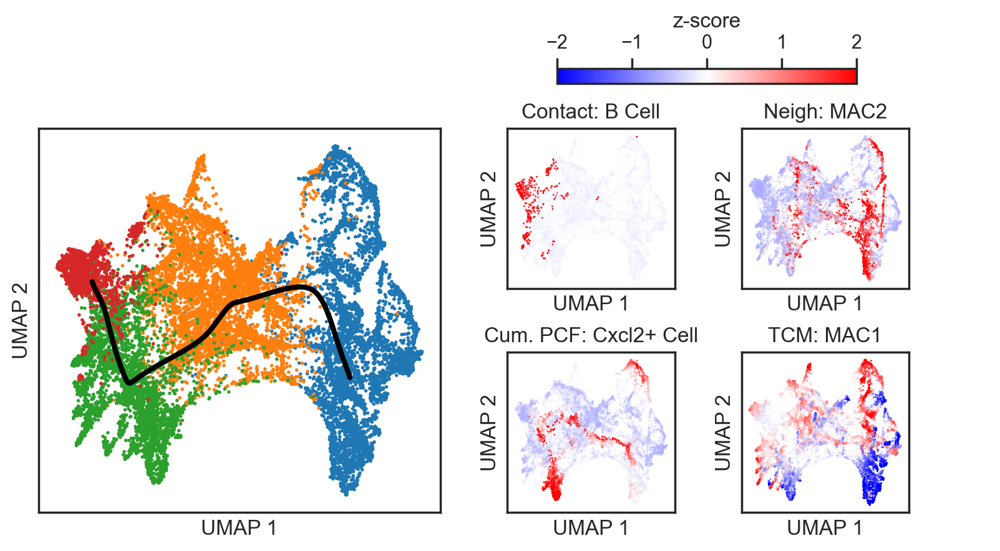

In [48]:
# Set parameters for scatter plot sizes and transparency
size_large = 4  # Size of large points
size_small = 1   # Size of small points
alpha = 1        # Transparency level for better visibility

# Get the order of columns, excluding those in the ignore list
order_of_columns = list_of_fib_spatial_vectors[0].columns
order_of_columns = [col for col in order_of_columns if col not in ignore_list]

# Define scatter plot parameters
scatter_paras = dict(edgecolor='none', linestyle='None', vmin=-2, vmax=2, cmap='bwr')

# Prepare data for different plots
data_2_0 = data_z[:, order_of_columns.index('Cumm_PCF_Cxcl2+ Cell')]
alpha_2_0 = np.abs(data_2_0)
alpha_2_0[alpha_2_0 > scatter_paras['vmax']] = scatter_paras['vmax']
alpha_2_0 = alpha_2_0 / scatter_paras['vmax']
title_2_0 = 'Cum. PCF: Cxcl2+ Cell'

data_0_2 = data_z[:, order_of_columns.index('Direct_contact_B Cell')]
alpha_0_2 = np.abs(data_0_2)
alpha_0_2[alpha_0_2 > scatter_paras['vmax']] = scatter_paras['vmax']
alpha_0_2 = alpha_0_2 / scatter_paras['vmax']
title_0_2 = 'Contact: B Cell'

data_1_2 = data_z[:, order_of_columns.index('Three_hop_Macrophage Type 2')]
alpha_1_2 = np.abs(data_1_2)
alpha_1_2[alpha_1_2 > scatter_paras['vmax']] = scatter_paras['vmax']
alpha_1_2 = alpha_1_2 / scatter_paras['vmax']
title_1_2 = 'Neigh: MAC2'

data_2_1 = data_z[:, order_of_columns.index('TCM_Macrophage Type 1')]
alpha_2_1 = np.abs(data_2_1)
alpha_2_1[alpha_2_1 > scatter_paras['vmax']] = scatter_paras['vmax']
alpha_2_1 = alpha_2_1 / scatter_paras['vmax']
title_2_1 = 'TCM: MAC1'

# Create a figure for the plots
fig = plt.figure(figsize=(9, 4))

# Create a 3x3 grid of subplots
grid = plt.GridSpec(2, 4, figure=fig, wspace=0.4, hspace=0.4)

# Central scatter plot
central_ax = fig.add_subplot(grid[0:2, 0:2])
for t in focus_cells:
    central_ax.scatter(umap_embedding[types_list == t, 0], umap_embedding[types_list == t, 1],
                       label=t, s=size_large, color=cell_color_final[t], **scatter_paras)
central_ax.set_xticks([])
central_ax.set_yticks([])
central_ax.set_xlabel('UMAP 1')
central_ax.set_ylabel('UMAP 2')
# Plot the trajectory on top of the scatter plot
central_ax.plot(smoothed_trajectory[:, 0], smoothed_trajectory[:, 1], color='black', linewidth=3)


# Scatter plot for Direct Contact B Cell
ax_1 = fig.add_subplot(grid[0, 2])
ax_1.scatter(umap_embedding[:, 0], umap_embedding[:, 1], s=size_small, c=data_0_2,
             alpha=alpha_0_2, **scatter_paras)
ax_1.set_xticks([])
ax_1.set_yticks([])
ax_1.set_xlabel('UMAP 1')
ax_1.set_ylabel('UMAP 2')
ax_1.set_title(title_0_2)

# Scatter plot for Neigh: Mac.Type.2
ax_2 = fig.add_subplot(grid[0, 3])
ax_2.scatter(umap_embedding[:, 0], umap_embedding[:, 1], s=size_small, c=data_1_2,
             alpha=alpha_1_2, **scatter_paras)
ax_2.set_xticks([])
ax_2.set_yticks([])
ax_2.set_xlabel('UMAP 1')
ax_2.set_ylabel('UMAP 2')
ax_2.set_title(title_1_2)

# Colorbar for the plots
ax_3 = fig.add_axes([0.47, 0.8, 0.5, 0.2])
norm = plt.Normalize(vmin=-2, vmax=2)
cbar = fig.colorbar(plt.cm.ScalarMappable(norm=norm, cmap='bwr'), ax=ax_3, orientation='horizontal', location='top')
cbar.set_label('z-score')
ax_3.axis('off')

# Scatter plot for Cum.PCF: Cxcl2+.Cell
ax_4 = fig.add_subplot(grid[1, 2])
ax_4.scatter(umap_embedding[:, 0], umap_embedding[:, 1], s=size_small, c=data_2_0,
             alpha=alpha_2_0, **scatter_paras)
ax_4.set_xticks([])
ax_4.set_yticks([])
ax_4.set_xlabel('UMAP 1')
ax_4.set_ylabel('UMAP 2')
ax_4.set_title(title_2_0)

# Scatter plot for TCM: Mac.Type.1
ax_5 = fig.add_subplot(grid[1, 3])
ax_5.scatter(umap_embedding[:, 0], umap_embedding[:, 1], s=size_small, c=data_2_1,
             alpha=alpha_2_1, **scatter_paras)
ax_5.set_xticks([])
ax_5.set_yticks([])
ax_5.set_xlabel('UMAP 1')
ax_5.set_ylabel('UMAP 2')
ax_5.set_title(title_2_1)

# Make the figure background transparent
fig.patch.set_alpha(0.0)